<img src="../../docs/images/dlsia.png" width=600 />

# Ensemble Learning with Randomized Sparse Mixed-Scale Networks

**Authors:** Eric Roberts and Petrus Zwart

**E-mail:** PHZwart@lbl.gov, EJRoberts@lbl.gov

We will train 13 different randomized sparse mixed-scale networks (SMSNets) to perform binary segmentation of retinal vessels on the [Structured Analysis of the Retina (STARE) dataset](https://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=845178&casa_token=G-hRLLwrHrcAAAAA:t8htUdrSm0gZlAPxjYdwDKkW2RJyWonfHeA2YPAUC76INDlBhzlMsQPXCF0VVsUpXLjNKmw91Q&tag=1). 

After training, we combine the best performing networks into a single estimator and return both the mean and standard deviation of the estimated class probabilities. We subsequently use [conformal estimation](https://arxiv.org/pdf/2107.07511.pdf) to get calibrated conformal sets that are guaranteed to contain the right label, with user-specified probability.

## Imports and helper functions

In [1]:
import numpy as np
import pandas as pd
import math
import torch
import torch.nn as nn
from torch.nn import functional
import torch.optim as optim
from torch.utils.data import TensorDataset

import torchvision
from torchvision import transforms

from dlsia.core import helpers
from dlsia.core import train_scripts
from dlsia.core.networks import smsnet
from dlsia.core.networks import baggins
from dlsia.core.conformalize import conformalize_segmentation
from dlsia.viz_tools import plots
from dlsia.viz_tools import draw_sparse_network

import matplotlib.pyplot as plt

import einops
import os

In [2]:
# we need to unzip images
import gzip, shutil, fnmatch
def gunzip(file_path,output_path):
    with gzip.open(file_path,"rb") as f_in, open(output_path,"wb") as f_out:
        shutil.copyfileobj(f_in, f_out)
        os.remove(file_path)

def unzip_directory(directory):
    walker = os.walk(directory)
    for directory,dirs,files in walker:
        for f in files:
            if fnmatch.fnmatch(f,"*.gz"):
                gunzip(directory+f,directory+f.replace(".gz",""))

## Download and view data

First, we need to download the STARE data, a dataset for semantic segmentation of retinal blood vessel commonly used as a benchmark. 

All data will be stored in a freshly created directory titled ```tmp/STARE_DATA```

In [3]:
import requests, tarfile

# make directories
path_to_data = "/tmp/"
if not os.path.isdir(path_to_data+'STARE_DATA'):
    os.mkdir(path_to_data+'STARE_DATA')
    os.mkdir(path_to_data+'STARE_DATA/images')
    os.mkdir(path_to_data+'STARE_DATA/labels')

    # get the data first
    url = 'https://cecas.clemson.edu/~ahoover/stare/probing/stare-images.tar'
    r = requests.get(url, allow_redirects=True)
    tmp = open(path_to_data+'STARE_DATA/stare-vessels.tar', 'wb').write(r.content)
    my_tar = tarfile.open(path_to_data+'STARE_DATA/stare-vessels.tar')
    my_tar.extractall(path_to_data+'STARE_DATA/images/')
    my_tar.close()

    unzip_directory(path_to_data+'STARE_DATA/images/')


    # get the ah-labels
    url = 'https://cecas.clemson.edu/~ahoover/stare/probing/labels-ah.tar'
    r = requests.get(url, allow_redirects=True)
    tmp = open(path_to_data+'STARE_DATA/labels-ah.tar', 'wb').write(r.content)
    my_tar = tarfile.open(path_to_data+'STARE_DATA/labels-ah.tar')
    my_tar.extractall(path_to_data+'STARE_DATA/labels/')
    my_tar.close()
    unzip_directory(path_to_data+'STARE_DATA/labels/')

### Transform data

Here we cast all images from numpy arrays to pytorch tensors and prep data for training

In [4]:
dataset = torchvision.datasets.ImageFolder(path_to_data+"STARE_DATA/", transform=transforms.ToTensor())
images = [np.array(dataset[i][0].permute(1,2,0)) for i in range(len(dataset)) if dataset[i][1] == 0]        
images = torch.stack([torch.Tensor(image).permute(2, 0, 1) for image in images])
labels = torch.stack([dataset[i][0] for i in range(len(dataset)) if dataset[i][1] == 1])
labels = torch.sum(labels, dim=1)
labels = torch.unsqueeze(labels, 1)
labels = torch.where(labels != 0, 1, 0)
#make if divisional friendly
images = images[:,:,:600,:]
labels = labels[:,:,:600,:]

downsample_factor=2
images = functional.interpolate(images, 
                                size=(images.shape[-2]//downsample_factor, 
                                      images.shape[-1]//downsample_factor), 
                                mode="bilinear")
labels = functional.interpolate(labels.type(torch.FloatTensor), 
                                size=(labels.shape[-2]//downsample_factor, 
                                      labels.shape[-1]//downsample_factor), 
                                mode="nearest")
all_ds = TensorDataset(images,labels)
test_ds = TensorDataset(images[0:2],labels[0:2].type(torch.LongTensor))
val_ds = TensorDataset(images[2:3],labels[2:3].type(torch.LongTensor))
train_ds = TensorDataset(images[3:],labels[3:].type(torch.LongTensor))


print("Size of train dataset:", len(train_ds))
print("Size of validation dataset:", len(val_ds))
print("Size of test dataset:", len(test_ds))

Size of train dataset: 17
Size of validation dataset: 1
Size of test dataset: 2


### View data


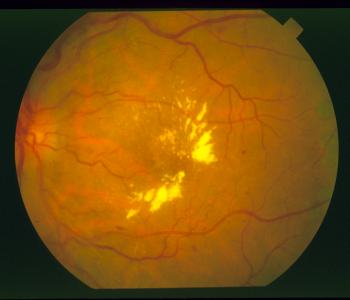

<Figure size 160x120 with 0 Axes>

In [5]:
params = {}
params["title"]="Image and Labels"
img = images[0].permute(1,2,0)
lbl = labels[0][0]
fig = plots.plot_rgb_and_labels(img.numpy(), lbl.numpy(), params)
fig.update_layout(width=700)
plt.figure(dpi=25) 
plt.tight_layout()
fig.show()

### Dataloader class

We make liberal use of the PyTorch Dataloader class for easy handling and iterative loading of data into the networks and models. 

With the chosen batch_size of 2, training requires roughly 4.5 to 6.0 GBs of GPU memory. Please note, memory comsumption is not static as network connectivity/sparsity is not static.

In [6]:
# create data loaders
num_workers = 0   

train_loader_params = {'batch_size': 2, 
                 'shuffle': True,
                 'num_workers': num_workers, 
                 'pin_memory':False,
                 'drop_last': False}

test_loader_params = {'batch_size': len(test_ds), 
                 'shuffle': False,
                 'num_workers': num_workers, 
                 'pin_memory':False,
                 'drop_last': False}

train_loader = torch.utils.data.DataLoader(train_ds, **train_loader_params)
val_loader = torch.utils.data.DataLoader(val_ds, **train_loader_params)
test_loader = torch.utils.data.DataLoader(test_ds, **test_loader_params)

print(train_ds.tensors[0].shape)

torch.Size([17, 3, 300, 350])


## Create random sparse networks

Define SMSNet (Sparse Mixed-Scale Network) architecture-governing hyperparameters here. 

### Specify hyperparameters

First, each random network will have the same number of layers/nodes. These hyperparameters dicate the layout, or topology, of all networks.

In [7]:
in_channels = 3 # RGB input image
out_channels = 2 # binary output

# we will use 15 hidden layers (typical MSDNets are >50)
num_layers = 15 

Next, the hyperparameters below govern the random network connectivity. Choices include: 

- alpha : modifies distribution of consecutive connection length between network layers/nodes,
- gamma : modifies distribution of of layer/node degree,
- IL : probability of connection between Input node and Layer node, 
- IO : probability of connection between Input node and Output node,
- LO : probability of connection between Layer node and Output node,
- dilation_choices :  set of possible dilations along each individual node connection


The specific parameters and what they do are described in detail in the documentation. Please follow minor  minor comments below for a more cursory explanation.

In [8]:
# When alpha > 0, short-range skip connections are favoured
alpha = 0.50 

# When gamma is 0, the degree of each node is chosen uniformly between 0 and max_k
# specifically, P(degree) \propto degree^-gamma
gamma = 0.0

# we can limit the maximum and minimum degree of our graph 
max_k = 5 
min_k = 3

# features channel posibilities per edge
hidden_out_channels = [10] 

# possible dilation choices
dilation_choices = [1,2,3,4,8,16] 

# Here are some parameters that define how networks are drawn at random
# the layer probabilities dictionairy define connections
layer_probabilities={'LL_alpha':alpha,
                     'LL_gamma': gamma,
                     'LL_max_degree':max_k,
                     'LL_min_degree':min_k,
                     'IL': 0.25,
                     'LO': 0.25,
                     'IO': True}

# if desired, one can introduce scale changes (down and upsample)
# a not-so-thorough look indicates that this isn't really super beneficial
# in the model systems we looked at
sizing_settings = {'stride_base':2, #better keep this at 2
                   'min_power': 0,
                   'max_power': 0}

# defines the type of network we want to build
network_type = "Classification"



## Build networks and train

We specify the number of random networks to initialize and the number of epochs for each is trained.

In [9]:
# build the networks
nets = []          # we want to store a number of them
performance = []   # and keep track of how well they do
n_networks = 7     # number of random networks to create
epochs = 10       # set number of training epochs


### Training loop

Now we cycle through each individual network and train.

Network 1


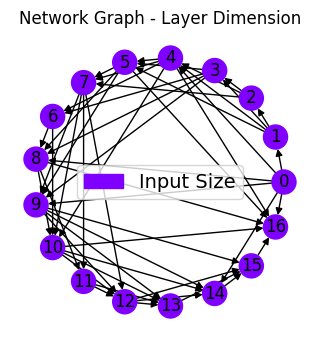

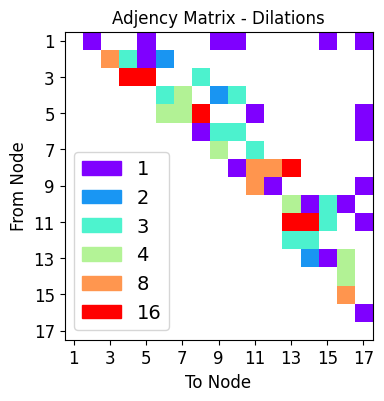

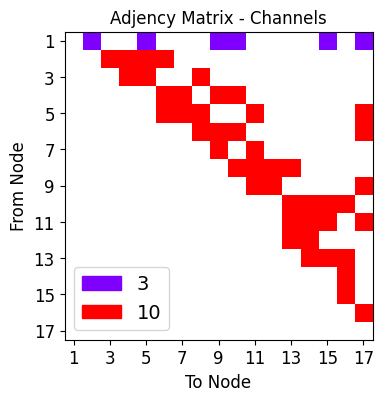

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  94858
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 1.5663e-01 | Validation Loss: 1.9539e-01
   Micro Training F1: 0.9549 | Micro Validation F1: 0.9425
   Macro Training F1: 0.8443 | Macro Validation F1: 0.7863


Network 2


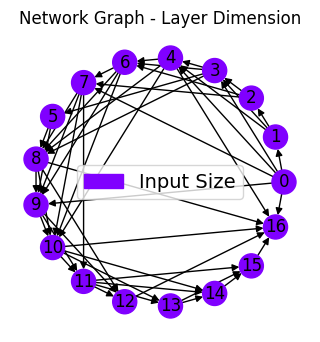

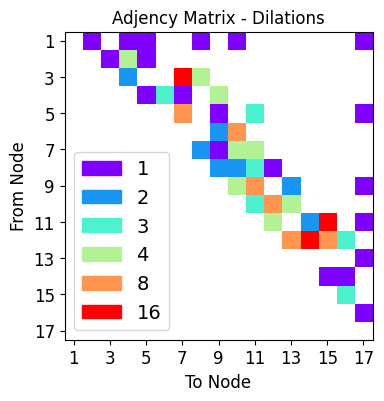

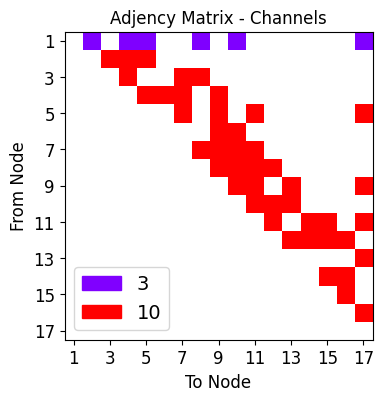

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  98238
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 1.4278e-01 | Validation Loss: 1.7614e-01
   Micro Training F1: 0.9588 | Micro Validation F1: 0.9485
   Macro Training F1: 0.8585 | Macro Validation F1: 0.8110


Network 3


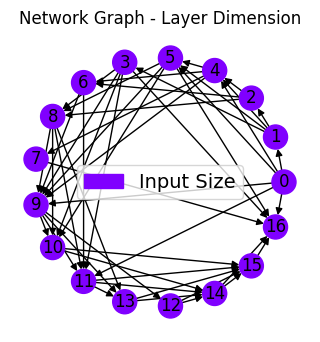

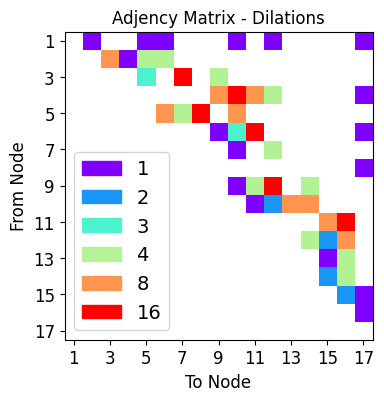

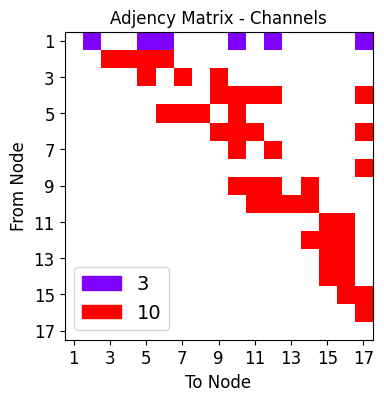

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  88078
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 1.6323e-01 | Validation Loss: 1.9523e-01
   Micro Training F1: 0.9556 | Micro Validation F1: 0.9439
   Macro Training F1: 0.8384 | Macro Validation F1: 0.7984


Network 4


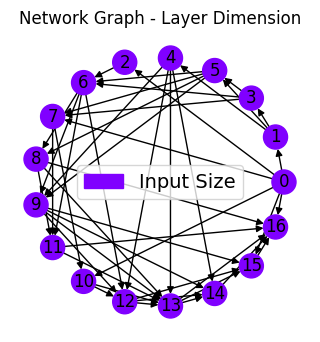

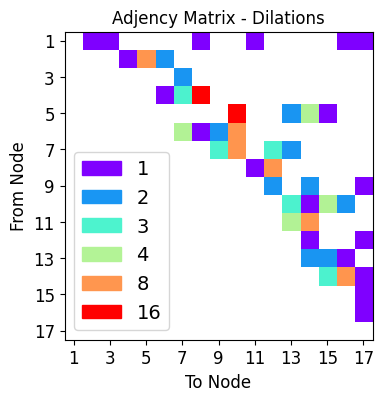

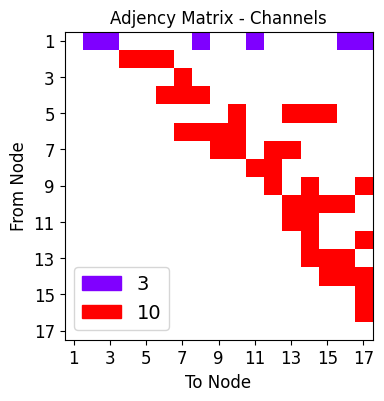

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  74088
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 1.6424e-01 | Validation Loss: 1.8995e-01
   Micro Training F1: 0.9551 | Micro Validation F1: 0.9443
   Macro Training F1: 0.8385 | Macro Validation F1: 0.7940


Network 5


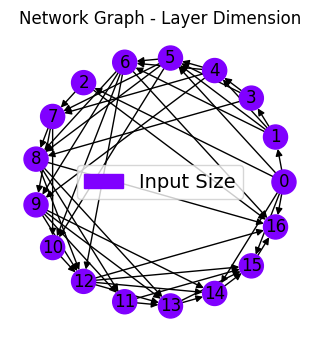

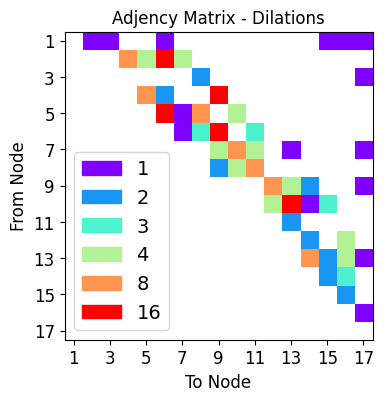

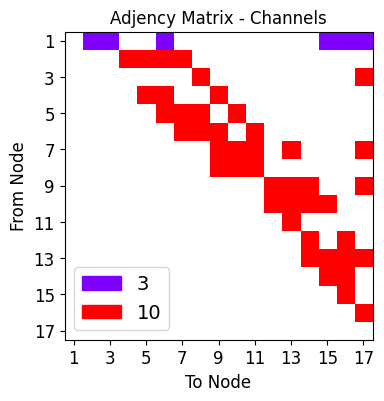

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  94278
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 2.0019e-01 | Validation Loss: 2.1542e-01
   Micro Training F1: 0.9480 | Micro Validation F1: 0.9409
   Macro Training F1: 0.8016 | Macro Validation F1: 0.7588


Network 6


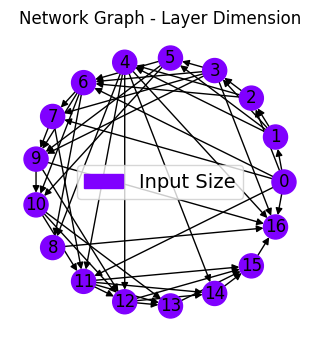

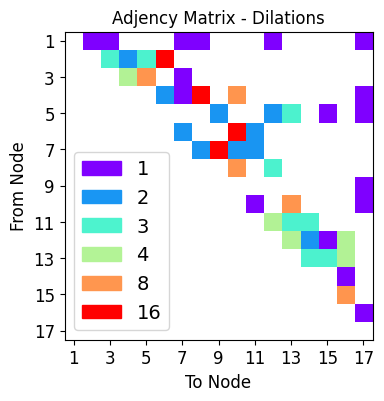

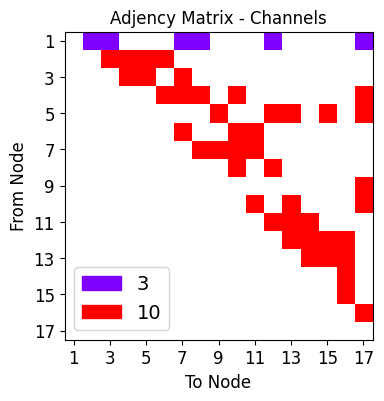

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  86978
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 1.5282e-01 | Validation Loss: 1.8299e-01
   Micro Training F1: 0.9568 | Micro Validation F1: 0.9455
   Macro Training F1: 0.8492 | Macro Validation F1: 0.7999


Network 7


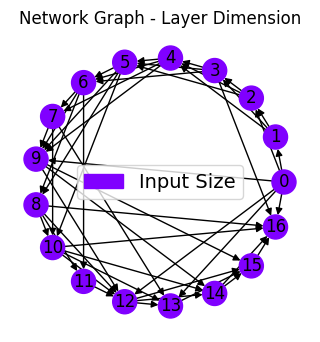

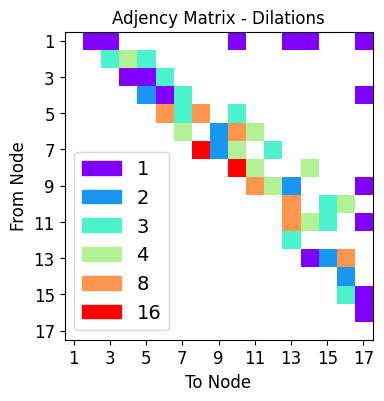

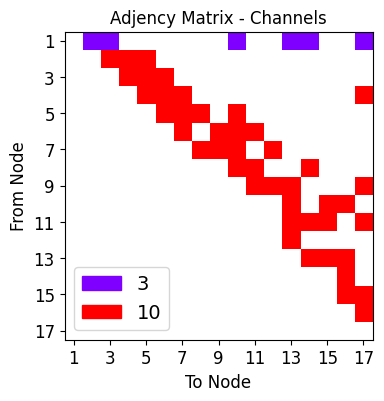

<Figure size 160x120 with 0 Axes>

Start training
Total number of refineable parameters:  94928
Epoch 10 of 10 | Learning rate 1.000e-03
   Training Loss: 2.1428e-01 | Validation Loss: 2.3745e-01
   Micro Training F1: 0.9449 | Micro Validation F1: 0.9316
   Macro Training F1: 0.7923 | Macro Validation F1: 0.7468


In [10]:
for ii in range(n_networks):
    torch.cuda.empty_cache()
    print("Network %i"%(ii+1))
    net = smsnet.random_SMS_network(in_channels=in_channels,
                                    out_channels=out_channels,
                                    in_shape=(300,300),
                                    out_shape=(300,300),
                                    sizing_settings=sizing_settings,
                                    layers=num_layers,\
                                    dilation_choices=dilation_choices,
                                    hidden_out_channels=hidden_out_channels,
                                    layer_probabilities=layer_probabilities,
                                    network_type=network_type)
    
    # lets plot the network
    net_plot,dil_plot,chan_plot = draw_sparse_network.draw_network(net)
    plt.figure(dpi=25) 
    plt.show()

    nets.append(net)
    
    print("Start training")
    pytorch_total_params = sum(p.numel() for p in net.parameters() if p.requires_grad)
    print("Total number of refineable parameters: ", pytorch_total_params)

    weights = torch.tensor([1.0,2.0]).to('cuda')
    criterion = nn.CrossEntropyLoss(weight=weights)   # For segmenting 
    learning_rate = 1e-3
    optimizer = optim.Adam(net.parameters(), lr=learning_rate)
    
    device = helpers.get_device()
    net = net.to(device)
    tmp = train_scripts.train_segmentation(net, 
                                           train_loader, 
                                           test_loader, 
                                           epochs,
                                           criterion, 
                                           optimizer, 
                                           device, 
                                           show=10)
    performance.append(tmp[1]["F1 validation macro"][tmp[1]["Best model index"]])
    net.save_network_parameters("stare_sms_%i.pt"%ii)
    net = net.cpu()
    plots.plot_training_results_segmentation(tmp[1]).show()
    
    # clear out unnecessary variables from device (GPU) memory after each network
    torch.cuda.empty_cache()

## Network evaluation

Select networks based on performance to build a conformal estimator.

PyMSDtorch conformal operations and documentation can be found in pyMSDtorch/core/conformalize directory.

In [11]:
sel = np.where(np.array(performance) > 0.78 )[0]
these_nets = []
for ii in sel:
    these_nets.append(nets[ii])
bagged_model = baggins.model_baggin(these_nets,"classification", False)
conf_obj = conformalize_segmentation.build_conformalizer_classify(bagged_model,
                                     test_loader,
                                     alpha=0.10,
                                     missing_label=-1,
                                     device='cuda:0',
                                     norma=True)

### Conformal estimation

In conformal estimation, we need to decide upon a confidence limit alpha. If desired, the parameter alpha can be changed. The lower it gets, the more 'noise' is included in the conformal set. We will set this value at 5% for now, and choose to select all pixels that has a 'vein' classification in their set as a possible 'vein' pixel. 

In [12]:
alpha = 0.10
conf_obj.recalibrate(alpha)
conformal_set = conf_obj(bagged_model(images[0:1]))
possible_veins = conformalize_segmentation.has_label_in_set(conformal_set,1)
mean_p, std_p = bagged_model(images[0:1], 'cuda:0', True)

### View results


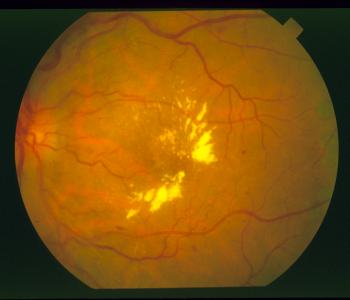


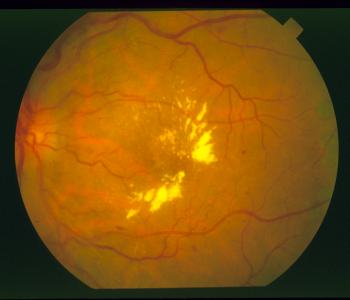


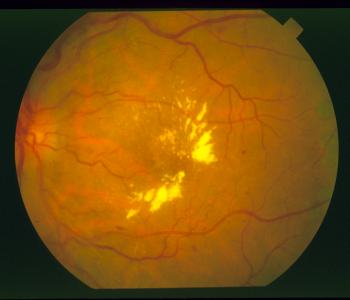


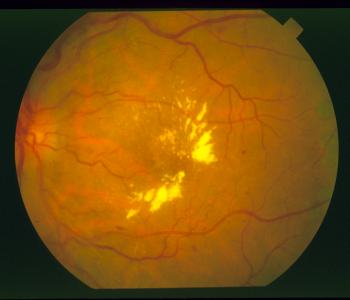

<Figure size 160x120 with 0 Axes>

<Figure size 160x120 with 0 Axes>

<Figure size 160x120 with 0 Axes>

<Figure size 160x120 with 0 Axes>

In [13]:
params = {}
params["title"]="Image and Labels - Ground Truth"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, lbl, params)
fig.update_layout(width=700)
plt.figure(dpi=25) 
fig.show()

params["title"]="Image and Labels - Estimated labels (conformal alpha = %3.2f )"%alpha
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, possible_veins.numpy()[0], params)
fig.update_layout(width=700)
plt.figure(dpi=25) 
fig.show()

params["title"]="Image and Class Probability Map"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, mean_p.numpy()[0,1], params)
fig.update_layout(width=700)
plt.figure(dpi=25) 
fig.show()

params["title"]="Image and Uncertainty of Estimated labels"
img = images[0].permute(1,2,0).numpy()
lbl = labels[0,0].numpy()
fig = plots.plot_rgb_and_labels(img, std_p.numpy()[0,1], params)
fig.update_layout(width=700)
plt.figure(dpi=25) 
fig.show()


### F1 performance metrics

In [14]:
F1_score_labels = train_scripts.segmentation_metrics(mean_p, labels[0:1,0,...].type(torch.LongTensor))
print( "Micro F1: %5.4f"%F1_score_labels[0].item())
print( "Macro F1: %5.4f"%F1_score_labels[1].item())

Micro F1: 0.9512
Macro F1: 0.8374


In [15]:
!ls -lh

total 69M
-rw-rw-r-- 1 ejroberts ejroberts  615 Jan 26 14:35 copy_all.py
-rw-rw-r-- 1 ejroberts ejroberts 5.9M Feb  6 00:11 denoising_MSDNet_SMSNetEnsemble.ipynb
-rw-rw-r-- 1 ejroberts ejroberts 1.4M Feb  5 22:55 denoising_selfSupervised.ipynb
-rw-rw-r-- 1 ejroberts ejroberts 5.7M Feb  6 10:09 ensembleLearning_SMSNets.ipynb
drwxrwxr-x 2 ejroberts ejroberts 4.0K Jan 27 12:43 ensembleNetworks
-rw-rw-r-- 1 ejroberts ejroberts 5.6M Feb  5 23:08 imageClassification_SMSNetAutoencoderEnsemble.ipynb
-rw-rw-r-- 1 ejroberts ejroberts 4.3M Feb  5 23:08 imageClassification_SMSNetEnsemble.ipynb
-rw-rw-r-- 1 ejroberts ejroberts    0 Jan 26 14:35 __init__.py
-rw-rw-r-- 1 ejroberts ejroberts 859K Feb  5 23:10 latentSpaceExploration_SMSNetAutoencoders.ipynb
-rwxrwxr-x 1 ejroberts ejroberts 1.3K Feb  5 12:42 run_all.sh
-rw-rw-r-- 1 ejroberts ejroberts  30K Feb  5 23:10 saving_loading_networks.ipynb
-rw-rw-r-- 1 ejroberts ejroberts 4.4M Feb  6 10:20 segmentation_MSDNet_TUNet_TUNet3plus.ipynb
-rw-rw-r-- 1